In [1]:
import os
import sys
import datetime
import math
import numpy as np
import matplotlib.pyplot as plt
import random
from imageio import imread
import json
import torch
torch.cuda.empty_cache()

from torch import Tensor
import torch.nn as nn
import torch.nn.functional as F
import pandas as pd

current_dir = os.path.dirname(os.path.realpath('__file__'))
import utils
from utils import plot_3d_slices
from utils import set_seeds
from utils import set_device
#from utils import get_optimizer_nn
from utils import init_weights_xavier
from utils import get_patch_size
from utils import Log
data_dir = os.path.join(current_dir, 'data')

from training_pipnet_LR import get_network,get_optimizer_nn
sys.path.append(data_dir)
#from make_dataset import get_dataloaders
import make_dataset_LR
from make_dataset_LR import get_dataloaders,getAllDataloader,getAllDataset
# Construct the path to the models directory
models_dir = os.path.join(current_dir, 'models')

# Add the models directory to sys.path
sys.path.append(models_dir)
from resnet_features import video_resnet18_features
from pipnet import PIPNet,NonNegLinear
from train_model_custom import train_pipnet

from test_model import eval_pipnet

vis_dir=os.path.join(current_dir, 'visualization')
sys.path.append(vis_dir)
import vis_pipnet
#from vis_pipnet import visualize, visualize_topk
from vis_pipnet import get_img_coordinates,plot_rgb_slices,plot_local_explanation
import plotly.graph_objects as go
import xarray as xr
import plotly.express as px


from monai.transforms import (
    Compose,
    Resize,
    RandRotate,
    Affine,
    RandGaussianNoise,
    RandZoom,
    RepeatChannel,
)
import math
import joblib
import h5py
from importlib import reload


In [40]:
reload(make_dataset_LR)

<module 'make_dataset_LR' from 'e:\\data\\mri\\PIPnet3D\\make_dataset_LR.py'>

In [2]:
def sliceViewer(images,labels, key: str, title: str, height:int):
    if len(images.shape)==3:
        newIm=RepeatChannel(3)(images.unsqueeze(0))
        newIm=torch.moveaxis(newIm,[0,1,2,3],[-1,0,1,2])
    else:
        newIm=images
    xrData = xr.DataArray(
        data   = newIm,
        dims   = [key, 'row', 'col', 'rgb'],
        coords = {key: labels}
    )
    # Hide the axes
    #layout_dict = dict(yaxis_visible=False, yaxis_showticklabels=False, xaxis_visible=False, xaxis_showticklabels=False)
    layout_dict=dict()
    return px.imshow(xrData, title=title, animation_frame=key).update_layout(layout_dict)


In [9]:
def sliceViewer(images, labels, key: str, title: str, height: int):
    if len(images.shape) == 3:
        newIm = RepeatChannel(3)(images.unsqueeze(0))
        newIm = torch.moveaxis(newIm, [0, 1, 2, 3], [-1, 0, 1, 2])
    else:
        newIm = images
    xrData = xr.DataArray(
        data=newIm,
        dims=[key, 'row', 'col', 'rgb'],
        coords={key: labels}
    )

    layout_dict = dict()
    
    # Create a figure with a layout
    fig = go.Figure(layout=layout_dict)

    # Add the image as a trace
    fig.add_trace(go.Image(z=xrData, zmin=0, zmax=255, colorscale='gray', name=title))

    # Hide the axes
    fig.update_layout(xaxis_visible=False, xaxis_showticklabels=False, yaxis_visible=False, yaxis_showticklabels=False)

    return fig

In [3]:

args={
    'log_dir':'logs/OPNorm9995_tan2_backbone1en4_fold2',
    'seed':44,
    'experiment_folder':'data/experiment_1',
    'lr':.0001,
    'lr_net':.0001,
    'lr_block':.0001,
    'lr_class':.0001,
    'lr_backbone':.0001,
    'weight_decay':0,
    'gamma':.1,
    'step_size':1,
    'batch_size':15,
    'epochs':160,
    'epochs_pretrain':30,
    'freeze_epochs':0,
    'epochs_finetune':10,
    'num_classes':2,
    'channels':3,
    'net':"3Dresnet18",
    'num_features':0,
    'bias':False,
    'out_shape':1,
    'disable_pretrained':False,
    'optimizer':'Adam',
    'state_dict_dir_net':'',
    "dic_classes":{False:0,True:1},
    'val_split':.05,
    'test_split':.2,
    'defaultFinetune':True,
    'lr_finetune':.05,
    'flipTrain':False,
    'stratSampling':True,
    'excludePatients':['735','322','531','523','876','552'],
    'log_power':1,
    'img_shape':[54,121,74],
    'wshape':5, # this is assigned mid script and doesn't matter here
    'hshape':8, # these matter and should bechanged to correct vals for the analyzing_network
    'dshape':7,
    'patchsize':15,
}

channels=3
aug_prob = 1
rand_rot = 10                       # random rotation range [deg]
rand_rot_rad = rand_rot*math.pi/180 # random rotation range [rad]
rand_noise_std = 0.01               # std random Gaussian noise
rand_shift = 5                      # px random shift
min_zoom = 0.9
max_zoom = 1.1
transforms_dic = {
    'train': Compose([
        RandRotate(range_x=rand_rot_rad, 
                    range_y=rand_rot_rad, 
                    range_z=rand_rot_rad, 
                    prob=aug_prob),
        RandGaussianNoise(std=rand_noise_std, prob=aug_prob),
        Affine(translate_params=(rand_shift,
                                    rand_shift,
                                    rand_shift), 
                image_only=True),
        RandZoom(min_zoom=min_zoom, max_zoom=max_zoom, prob=aug_prob),
        RepeatChannel(repeats=channels),
    ]),
    'train_noaug': Compose([RepeatChannel(repeats=channels)]),
    'project_noaug':Compose([RepeatChannel(repeats=channels)]),
    'val': Compose([RepeatChannel(repeats=channels)]),
    'test': Compose([RepeatChannel(repeats=channels)]),
    'test_projection': Compose([RepeatChannel(repeats=channels)]),
}

downSample=3.2
lowerBound=.15
#inputData=f'data/FP923_LR_avgCrop_DS{int(downSample*10)}_point{int(lowerBound*100)}Thresh.h5'
inputData=f'data/FP_LR_OPNorm_avgcrop_DS{int(downSample*10)}_point{int(lowerBound*100)}Thresh.h5'

In [4]:
with open(f"{args['log_dir']}/kMeans_DS32.json","r") as f:
    kMeansFold=json.load(f)


In [4]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

#yflags=pd.read_csv("../duke/ClinicalFlags.csv",index_col=0)


dataloaders=get_dataloaders(dataset_h5path=inputData,
                            k_fold=5,
                            test_p=.2,
                            val_p=.05,
                            batchSize=args['batch_size'],
                            seed=args['seed'],
                            kMeansSaveDir="data/kMeans_DS32.json")

trainloader = dataloaders[0]
trainloader_pretraining = dataloaders[1]
trainloader_normal = dataloaders[2] 
trainloader_normal_augment = dataloaders[3]
projectloader = dataloaders[4]
valloader = dataloaders[5]
testloader = dataloaders[6] 
test_projectloader = dataloaders[7]

allData=getAllDataset(inputData)
inputKeys=allData.subsetKeys

In [8]:
arr,label=projectloader.dataset[inputKeys[10]]


tensor(0)


In [9]:
#arr,label=projectloader.dataset["109_R"]
arr,label=allData['20_R']
args['img_shape']=list(arr.shape[1:])
arr=RepeatChannel(repeats=3)(arr)
arr.shape

print(label)

tensor(1)


In [10]:
volume=arr
volumeRGB=np.moveaxis(volume,[0,1,2,3],[-1,0,1,2])

sliceViewer(volumeRGB,[i for i in range(len(volumeRGB))],key="Depth",title="test",height=700)

In [6]:
useGPU=True
devID=0
if useGPU:
    device=torch.device(f'cuda:{devID}')
else:
    device=torch.device('cpu')

In [7]:
network_layers = get_network(num_classes=args['num_classes'], args=args)
feature_net = network_layers[0]
add_on_layers = network_layers[1]
pool_layer = network_layers[2]
classification_layer = network_layers[3]
num_prototypes = network_layers[4]
newFeatures=feature_net
net = PIPNet(
        num_classes = args['num_classes'],
        num_prototypes = num_prototypes,
        feature_net = newFeatures,
        args = args,
        add_on_layers = add_on_layers,
        pool_layer = pool_layer,
        classification_layer = classification_layer
        )
net = net.to(device=device)
net = nn.DataParallel(net, device_ids = [0])  

Number of prototypes:  512


In [8]:
optimizer = get_optimizer_nn(net, args)
optimizer_net = optimizer[0]
optimizer_classifier = optimizer[1] 
params_to_freeze = optimizer[2] 
params_to_train = optimizer[3] 
params_backbone = optimizer[4]   

Network is  3Dresnet18


In [9]:
checkpointFile=f"{args['log_dir']}/checkpoints/net_trained_last"
checkpoint = torch.load(checkpointFile, map_location = device)
net.load_state_dict(checkpoint['model_state_dict'], strict = True) 
net.module._multiplier.requires_grad = False
try:
    optimizer_net.load_state_dict(
        checkpoint['optimizer_net_state_dict']) 
except:
    print("optimizer failed load")

## Gradient of proto featurization

In [13]:
xs=arr.unsqueeze(0).to(device)
xs.requires_grad=True
features = net.module._net(xs)

gradTensor=torch.autograd.grad(features[0][0][0][0][0],xs,retain_graph=True)
gradTensor2=torch.autograd.grad(features[0][0][0][0][1],xs)


### find the indices of z,r,c within a given proto through softmax, then sum the gradient of the relevent


In [ ]:
torch.sum()

In [44]:
topkProtos=[26, 30, 58, 76, 80, 95, 137, 172, 189, 190, 196, 206, 211, 229, 236, 252, 278, 282, 303, 327, 347, 366, 372, 384, 424, 450, 452, 458, 479, 507, 509]

outputFile=f"{args['log_dir']}/featuresGradient.h5"

thresh=.5

with h5py.File(f'{outputFile}','w') as gradientData:
    #image -> protos -> gradient
    ###eventually throw in simweights in this dataset for both classes
   
    for key in inputKeys: 
        grp=gradientData.create_group(key)
        arr,label=projectloader.dataset[key]
        grp.attrs['classLabel']=label
        xs=arr.unsqueeze(0).to(device)
        xs.requires_grad=True
        features = net.module._net(xs)
        proto_features = net.module._add_on(features) #does any form of gradient accrue on features here?
        proto_features=proto_features.detach().cpu()
        protoThresh=proto_features > thresh

        for proto in topkProtos:
            releventIndices=[(i,j,k) for i in range(features.shape[2]) for j in range(features.shape[3]) for k in range(features.shape[4]) if protoThresh[0][proto][i][j][k]==1]
            if len(releventIndices)>0:
                
                i,j,k=releventIndices[0]
                gradient=torch.autograd.grad(features[0][proto][i][j][k],xs,retain_graph=True)[0]
                for i,j,k in releventIndices[1:]:
                    gradient+=torch.autograd.grad(features[0][proto][i][j][k],xs,retain_graph=True)[0]
                gradient=gradient.detach().cpu().numpy()
                grp.create_dataset(f"proto{proto}",data=gradient[0],compression="gzip", compression_opts=6)


        

KeyboardInterrupt: 

In [50]:
gradient.shape

(1, 3, 51, 101, 72)

In [51]:

inputKeys[0]

'2_L'

'data/FP923_LR_avgCrop_DS32_point20Thresh.h5'

In [51]:
gradTensor[0].shape

torch.Size([1, 3, 51, 101, 72])

In [57]:
features.shape

torch.Size([1, 512, 7, 7, 5])

In [34]:
protoK=31
#[float(features[0][31][i][j][k]) for i in range(features.shape[2]) for j in range(features.shape[3])
#    for k in range(features.shape[4])]

proto_features = net.module._add_on(features)
proto_features=proto_features.detach().cpu()

In [35]:
protoThresh=proto_features > .5

In [36]:
proto=30

releventIndices=[(i,j,k) for i in range(features.shape[2]) for j in range(features.shape[3]) for k in range(features.shape[4]) if protoThresh[0][proto][i][j][k]==1]
#gradient=torch.autograd.grad(features[0][proto][protoThresh[0][proto]],xs,retain_graph=True)

In [42]:
topkProtos=[26, 30, 58, 76, 80, 95, 137, 172, 189, 190, 196, 206, 211, 229, 236, 252, 278, 282, 303, 327, 347, 366, 372, 384, 424, 450, 452, 458, 479, 507, 509]

for proto in topkProtos:
    releventIndices=[(i,j,k) for i in range(features.shape[2]) for j in range(features.shape[3]) for k in range(features.shape[4]) if protoThresh[0][proto][i][j][k]==1]
    if len(releventIndices)>0:
        print(proto)
        print(releventIndices)
        print("\n\n")

58
[(2, 1, 1)]



80
[(1, 3, 1)]



190
[(0, 2, 0)]



206
[(0, 1, 1)]



211
[(0, 3, 0)]



366
[(0, 3, 1)]



452
[(2, 2, 1)]



479
[(2, 2, 0)]



507
[(1, 1, 1)]



509
[(1, 2, 0), (1, 3, 0)]





In [37]:
sliceViewer(protoThresh[0][proto],labels=list(range(protoThresh.shape[2])),key='d',title="",height=600)

In [26]:
releventIndices

[]

torch.Size([241])

In [ ]:
features.shape

In [23]:
features[0][0][0][0].backward(gradient=torch.ones_like(xs))

RuntimeError: Mismatch in shape: grad_output[0] has a shape of torch.Size([1, 3, 51, 101, 72]) and output[0] has a shape of torch.Size([5]).

In [17]:
features.shape

torch.Size([1, 512, 7, 7, 5])

In [13]:
arr.shape

torch.Size([3, 51, 101, 72])

In [14]:
net.module._classification.bias

In [11]:
weightDetached=net.module._classification.weight.detach().cpu().numpy()

In [38]:
checkKeys=list({'18', '19', '20', '21', '25', '26', '29'})

#outputFile=f'data/checkKeys_flipped_projection_DS{int(downSample*10)}_point{int(lowerBound*100)}Thresh.h5'

outputFile=f"{args['log_dir']}/checkKeys_LR_projection_DS{int(downSample*10)}_point{int(lowerBound*100)}Thresh.h5"

patientData=[]


with h5py.File(inputData, 'r') as f:
    checkKeys=[i for i in checkKeys if str(i) in f.keys()]
    for key in checkKeys:
        for subKey in ["L","R"]:
            arr=f[key][subKey][:]
            #arr=arr[:,:,::-1].copy()
            arr=torch.tensor(arr).type(torch.float32)
            arr=torch.unsqueeze(arr,0)
            arr=transforms_dic['test_projection'](arr)
            patientData.append(arr)

#arr=arr.unsqueeze(0) -- only for size1  batch
with torch.no_grad():
    patientData=torch.tensor(np.asarray(patientData))
    patientData=patientData.to(device)
    proto_features, clamped_pooled, out = net(patientData)
    proto_features=proto_features.detach()
    clamped_pooled=clamped_pooled.detach()
    out=out.detach()
    weightDetached=net.module._classification.weight.detach().cpu().numpy()

with h5py.File(f'{outputFile}','w') as f:
    if(proto_features.shape[0]==clamped_pooled.shape[0]==out.shape[0]==len(checkKeys)*2):
        for i in range(len(patientData)):
            if i%2==0:
                grp=f.create_group(f"{checkKeys[i//2]}_L")
            else:
                grp=f.create_group(f"{checkKeys[i//2]}_R")
            grp.create_dataset('proto_features',data=proto_features.cpu()[i].numpy(),compression="gzip", compression_opts=6)
            grp.create_dataset('clamped_pooled',data=clamped_pooled.cpu()[i].numpy(),compression="gzip", compression_opts=6)
            grp.create_dataset('out',data=out.cpu()[i].numpy(),compression="gzip", compression_opts=6)
            
        
    else:
        f.create_dataset('proto_features',data=proto_features.cpu().numpy(),compression="gzip", compression_opts=6)
        f.create_dataset('clamped_pooled',data=clamped_pooled.cpu().numpy(),compression="gzip", compression_opts=6)
        f.create_dataset('out',data=out.cpu().numpy(),compression="gzip", compression_opts=6)
        print(f"batch mismatch in out save, all compiled for \n{checkKeys}")
    
    f.create_dataset("classWeights",data=weightDetached,compression="gzip", compression_opts=6)

In [42]:
checkKeys

['18', '19', '20', '21', '25', '26', '29', '30']

In [43]:
#reload dataloaders with specific kfold, then run through and save batches

epoch="last"
checkpointFile=f"{args['log_dir']}/checkpoints/net_trained_{epoch}"
checkpoint = torch.load(checkpointFile, map_location = device)
net.load_state_dict(checkpoint['model_state_dict'], strict = True) 
net.module._multiplier.requires_grad = False
weightDetached=net.module._classification.weight.detach().cpu().numpy()

try:
    optimizer_net.load_state_dict(
        checkpoint['optimizer_net_state_dict']) 
except:
    print("optimizer failed load")

outputFile=f"{args['log_dir']}/allKeys_LR_projection_DS{int(downSample*10)}_point{int(lowerBound*100)}Thresh_epoch{epoch}.h5"

batchSize=14

with h5py.File(f'{outputFile}','w') as output_h5:
    output_h5.create_dataset("classWeights",data=weightDetached,compression="gzip", compression_opts=6)
    with h5py.File(inputData, 'r') as input_h5:
        #batch loop -- or just feed in one at a time lol
        keys=list(input_h5.keys())
        #patientData=[] #def here for batching>2
        for i in range(len(keys)):
            #if len(patientData)%batchSize==0:
            #    patientData=[]
            patientData=[]
            for subKey in ["L","R"]:
                arr=input_h5[keys[i]][subKey][:]
                #arr=arr[:,:,::-1].copy()
                arr=torch.tensor(arr).type(torch.float32)
                arr=torch.unsqueeze(arr,0)
                arr=transforms_dic['test_projection'](arr)
                patientData.append(arr)
            
            with torch.no_grad():
                patientData=torch.tensor(np.asarray(patientData))
                patientData=patientData.to(device)
                proto_features, clamped_pooled, out = net(patientData)
                proto_features=proto_features.detach()
                clamped_pooled=clamped_pooled.detach()
                out=out.detach()
            for j in range(2):
                if j%2==0:
                    grp=output_h5.create_group(f"{keys[i]}_L")
                else:
                    grp=output_h5.create_group(f"{keys[i]}_R")
                grp.create_dataset('proto_features',data=proto_features.cpu()[j].numpy(),compression="gzip", compression_opts=6)
                grp.create_dataset('clamped_pooled',data=clamped_pooled.cpu()[j].numpy(),compression="gzip", compression_opts=6)
                grp.create_dataset('out',data=out.cpu()[j].numpy(),compression="gzip", compression_opts=6)

            




### implementation of vis_pipnet tools

In [8]:
dataloaders=get_dataloaders(dataset_h5path=inputData,
                            k_fold=5,
                            test_p=.2,
                            val_p=.05,
                            batchSize=args['batch_size'],
                            seed=args['seed'],
                            kMeansSaveDir="data/kMeans_DS32.json")

trainloader = dataloaders[0]
trainloader_pretraining = dataloaders[1]
trainloader_normal = dataloaders[2] 
trainloader_normal_augment = dataloaders[3]
projectloader = dataloaders[4]
valloader = dataloaders[5]
testloader = dataloaders[6] 
test_projectloader = dataloaders[7]

In [13]:
checkKeys=list({'18', '19', '20', '21', '25', '26', '29'})
checkKey='18'

epoch="last"
checkpointFile=f"{args['log_dir']}/checkpoints/net_trained_{epoch}"
checkpoint = torch.load(checkpointFile, map_location = device)
net.load_state_dict(checkpoint['model_state_dict'], strict = True) 
net.module._multiplier.requires_grad = False
weightDetached=net.module._classification.weight.detach().cpu().numpy()

try:
    optimizer_net.load_state_dict(
        checkpoint['optimizer_net_state_dict']) 
except:
    print("optimizer failed load")

outputFile=f"{args['log_dir']}/allKeys_LR_projection_DS{int(downSample*10)}_point{int(lowerBound*100)}Thresh_epoch{epoch}.h5"



with h5py.File(outputFile, 'r') as input_h5:
    
    proto_features=input_h5[f"{checkKey}_L"]['proto_features'][:]

with h5py.File(inputData, 'r') as input_h5:
    arr=input_h5[checkKey]["L"][:]

In [18]:
proto_features.shape
### resize proto_features to size of image

## assign args d/h/w-shape here


(512, 7, 7, 5)

In [10]:
foldername="testvis"
save=True
k=10
dir = os.path.join(args['log_dir'], foldername)
if save:
    if not os.path.exists(dir):
        os.makedirs(dir)

classification_weights = net.module._classification.weight

near_imgs_dirs = dict()
seen_max = dict()
saved = dict()
saved_ys = dict()
tensors_per_prototype = dict()
img_prototype = dict()
proto_coord = dict()

for p in range(net.module._num_prototypes):
    near_imgs_dir = os.path.join(dir, str(p))
    near_imgs_dirs[p] = near_imgs_dir
    seen_max[p] = 0.
    saved[p] = 0
    saved_ys[p] = []
    tensors_per_prototype[p] = []
    img_prototype[p] = []
    proto_coord[p] = []

net.eval()


DataParallel(
  (module): PIPNet(
    (_net): VideoResNet_features(
      (stem): BasicStem(
        (0): Conv3d(3, 64, kernel_size=(3, 7, 7), stride=(1, 2, 2), padding=(1, 3, 3), bias=False)
        (1): BatchNorm3d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace=True)
      )
      (layer1): Sequential(
        (0): BasicBlock(
          (conv1): Sequential(
            (0): Conv3DSimple(64, 64, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=(1, 1, 1), bias=False)
            (1): BatchNorm3d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): ReLU(inplace=True)
          )
          (conv2): Sequential(
            (0): Conv3DSimple(64, 64, kernel_size=(3, 3, 3), stride=(1, 1, 1), padding=(1, 1, 1), bias=False)
            (1): BatchNorm3d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          )
          (relu): ReLU(inplace=True)
        )
        (1): BasicBlock(
          (con

In [15]:
classification_weights.shape

torch.Size([2, 512])

In [11]:
patchsize, skip_z, skip_y, skip_x = get_patch_size(args)
patchsize, skip_z, skip_y, skip_x

(15, 6, 15, 15)

In [22]:
args['img_shape']

[54, 121, 74]

In [12]:
images_seen = 0
topks = dict()
subsetKeys=projectloader.dataset.subsetKeys
img_iter=enumerate(iter(projectloader))

for i, (xs, ys) in img_iter:
    images_seen += 1
    xs, ys = xs.to(device), ys.to(device)

    with torch.no_grad():
            
        # Use the model to classify this batch of input data
        pfs, pooled, _ = net(xs, inference = True)
        pooled = pooled.squeeze(0)      # [ps]
        pfs = pfs.squeeze(0)            # [ps,d,h,w] 
        for p in range(pooled.shape[0]):
            c_weight = torch.max(classification_weights[:, p]) 
            
            # ignore prototypes that are not relevant to any class
            if c_weight > 1e-3: 
                
                if p not in topks.keys():
                    # initialize
                    topks[p] = []
                    
                if len(topks[p]) < k:
                    # Add to topks:
                    # - image index in projectloader of xs
                    # - prototype presence score of p in xs
                    # REMEMBER: A prototype in PIP-Net is a node in the 
                    # neural network that is activated (output near 1) when 
                    # the prototypical part is detected in the input image, 
                    # and near 0 otherwise.
                    topks[p].append((i, pooled[p].item())) 
                    
                else:
                    # check what are the most activated images for the 
                    # prototype p
                    topks[p] = sorted(topks[p], 
                                        key = lambda tup: tup[1], 
                                        reverse = True)
                    if topks[p][-1][1] < pooled[p].item():
                        topks[p][-1] = (i, pooled[p].item())
                        
                    if topks[p][-1][1] == pooled[p].item():
                        # equal scores. randomly chose one (since dataset 
                        # is not shuffled so later images with same scores 
                        # can now also get in topk).
                        replace_choice = random.choice([0, 1])
                        if replace_choice > 0:
                            topks[p][-1] = (i, pooled[p].item())

alli = [] # index of input images which have the topk activation with 
            # similarity>0.1 for each relevant prototype
prototypes_not_used = []

# Check what are the prototypes with similarity (the ones detected in the
# training set) with similarity > 0.1
for p in topks.keys():
    found = False
    
    for idx, score in topks[p]:
        alli.append(idx)
        
        if score > 0.1:  
            # in case prototypes have fewer than k well-related patches
            found = True
            
    if not found:
        prototypes_not_used.append(p)
        

print(len(prototypes_not_used), "prototypes do not have any similarity \
        score > 0.1. Will be ignored in visualisation.")


0 prototypes do not have any similarity         score > 0.1. Will be ignored in visualisation.


In [13]:
topks.keys()

dict_keys([26, 34, 47, 51, 78, 87, 113, 125, 129, 178, 185, 188, 198, 219, 235, 239, 263, 283, 296, 298, 311, 327, 332, 366, 408, 410, 412, 463, 474, 490, 499])

In [25]:
len(topks)

31

In [26]:
topks[26]

[(738, 0.9996926784515381),
 (614, 0.9994763731956482),
 (487, 0.9994000196456909),
 (308, 0.9993643164634705),
 (576, 0.9992465972900391),
 (453, 0.9992315769195557),
 (327, 0.9992202520370483),
 (291, 0.9992095232009888),
 (883, 0.99904865026474),
 (556, 0.9990399479866028)]

In [14]:
protoChoice=26
assert protoChoice in topks.keys()

topkVec=np.array(topks[protoChoice])

indexMap={int(i[0]):projectloader.dataset.subsetKeys[int(i[0])] for i in topkVec}

In [28]:
topkVec

array([[738.        ,   0.99969268],
       [614.        ,   0.99947637],
       [487.        ,   0.99940002],
       [308.        ,   0.99936432],
       [576.        ,   0.9992466 ],
       [453.        ,   0.99923158],
       [327.        ,   0.99922025],
       [291.        ,   0.99920952],
       [883.        ,   0.99904865],
       [556.        ,   0.99903995]])

In [29]:
indexMap

{738: '711_L',
 614: '411_R',
 487: '765_L',
 308: '334_L',
 576: '681_L',
 453: '356_R',
 327: '253_L',
 291: '855_L',
 883: '558_R',
 556: '137_R'}

In [25]:
classification_weights.shape

torch.Size([2, 512])

In [15]:
abstained = 0
img_iter = enumerate(iter(projectloader))

for i, (xs, ys) in img_iter:
    
    # print(
    #     "Localize each relevant prototype with similarity > 0.1 as a", 
    #     "patch of the topk activated images in the training set,", i,
    #       flush=True)
    
    # shuffle is false so should lead to same order as in imgs
    if i in alli:
        
        xs, ys = xs.to(device), ys.to(device)
        
        # visualize only relevant prototypes (weights connection > 0 at 
        # least for one class)
        for p in topks.keys():
            
            # visualize only prototypes detected with similarity > 0.1
            if p not in prototypes_not_used:
                
                for idx, score in topks[p]:
                    
                    if idx == i:
                        # Use the model to classify this batch of input data
                        with torch.no_grad():

                            softmaxes, pooled, out = net(
                                xs, 
                                inference = True) # softmaxes: (1,ps,d,h,w)                 
                            outmax = torch.amax(
                                out, dim=1)[0]  # outmax: ([1]) as 
                                                #   projectloader's bs=1 
                            if outmax.item() == 0.:
                                abstained += 1
                        
                        # Take the maximum per prototype in feature's space 
                        # for image xs
                        
                        max_per_prototype, max_idx_per_prototype = \
                            torch.max(softmaxes, dim=0) # (ps,d,h,w)
                        
                        max_per_prototype_hw, max_idx_per_prototype_hw = \
                            torch.max(max_per_prototype, dim=1) # (ps,h,w)
                            
                        max_per_prototype_h, max_idx_per_prototype_h = \
                            torch.max(max_per_prototype_hw, dim=1) # (ps,w)
                            
                        max_per_prototype_w, max_idx_per_prototype_w = \
                            torch.max(max_per_prototype_h, dim=1) # (ps)
                        
                        c_weight = torch.max(classification_weights[:, p]) 
                        
                        # ignore prototypes that are not relevant to any 
                        # class
                        if (c_weight > 1e-10) or ('pretrain' in foldername):
                            
                            # get the coordinate of the maximum in the 
                            # feature's space
                            
                            d_idx = max_idx_per_prototype_hw[
                                p, 
                                max_idx_per_prototype_h[
                                    p, max_idx_per_prototype_w[p]], 
                                max_idx_per_prototype_w[p]].item()
                            
                            h_idx = max_idx_per_prototype_h[
                                p, max_idx_per_prototype_w[p]].item()
                            
                            w_idx = max_idx_per_prototype_w[p].item()

                            img_tensor,label=projectloader.dataset[i]
                            img_tensor=img_tensor.unsqueeze_(0)
                            ps_coord = get_img_coordinates(
                                    args['img_shape'][0], args['img_shape'][1],args['img_shape'][2], 
                                    softmaxes.shape, 
                                    patchsize, skip_z, skip_y, skip_x,
                                    d_idx, h_idx, w_idx)

                            d_min = ps_coord[0]
                            d_max = ps_coord[1]
                            h_min = ps_coord[2]
                            h_max = ps_coord[3]
                            w_min = ps_coord[4]
                            w_max = ps_coord[5]
                            
                            img_tensor_patch = img_tensor[
                                0, :, 
                                d_min:d_max, 
                                h_min:h_max, 
                                w_min:w_max]
                                    
                            saved[p]+=1
                            tensors_per_prototype[p].append(
                                img_tensor_patch.array)
                            img_prototype[p].append(subsetKeys[i])
                            proto_coord[p].append(ps_coord)
print("Abstained: ", abstained, flush = True)

Abstained:  0


In [32]:
subsetKeys

['203_R',
 '63_R',
 '538_L',
 '579_R',
 '95_R',
 '858_L',
 '38_R',
 '451_L',
 '212_L',
 '615_L',
 '404_R',
 '221_R',
 '639_L',
 '278_L',
 '921_R',
 '388_L',
 '604_L',
 '525_R',
 '719_L',
 '494_L',
 '476_L',
 '864_R',
 '354_L',
 '197_R',
 '806_R',
 '811_L',
 '416_L',
 '747_L',
 '910_R',
 '42_R',
 '781_R',
 '731_R',
 '28_R',
 '293_R',
 '719_R',
 '334_R',
 '429_L',
 '555_R',
 '414_L',
 '103_R',
 '125_L',
 '605_R',
 '492_L',
 '873_L',
 '493_L',
 '202_L',
 '49_L',
 '27_L',
 '480_R',
 '569_R',
 '907_R',
 '864_L',
 '277_R',
 '337_R',
 '708_L',
 '610_L',
 '478_L',
 '456_R',
 '618_R',
 '434_L',
 '839_R',
 '87_R',
 '9_R',
 '434_R',
 '437_R',
 '427_L',
 '195_R',
 '803_R',
 '124_L',
 '122_R',
 '695_L',
 '909_R',
 '627_L',
 '13_L',
 '377_R',
 '154_R',
 '418_R',
 '191_L',
 '157_R',
 '289_L',
 '256_R',
 '71_R',
 '554_R',
 '754_L',
 '686_R',
 '90_R',
 '181_R',
 '806_L',
 '541_R',
 '779_R',
 '571_R',
 '833_L',
 '391_R',
 '889_R',
 '39_R',
 '456_L',
 '788_R',
 '347_L',
 '577_R',
 '827_R',
 '277_L',
 '78

In [16]:
### i think that we should now have the info to call plot_local_explanation on the side, 

#allKeys_LR_projection_DS32_point20Thresh_epochlast.h5

classWeights=classification_weights.cpu().detach().numpy() # 2,512

plotKeys=['203_R']
explanations=[] # list of local explanations


plotProtos=set(topks.keys())#{278}


with h5py.File(f"{args['log_dir']}/allKeys_LR_projection_DS{int(downSample*10)}_point{int(lowerBound*100)}Thresh_epochlast.h5", 'r') as f:
    for patientKey in plotKeys:
        

        softmaxes=Tensor(f[patientKey]['proto_features'][:])
        pooled=f[patientKey]['clamped_pooled'][:]
        out=f[patientKey]['clamped_pooled'][:]

        xs,label=projectloader.dataset[patientKey]

        softmaxes=softmaxes.unsqueeze(0)
        max_per_prototype, max_idx_per_prototype = \
            torch.max(softmaxes, dim=0) # (ps,d,h,w)
        
        max_per_prototype_hw, max_idx_per_prototype_hw = \
            torch.max(max_per_prototype, dim=1) # (ps,h,w)
            
        max_per_prototype_h, max_idx_per_prototype_h = \
            torch.max(max_per_prototype_hw, dim=1) # (ps,w)
            
        max_per_prototype_w, max_idx_per_prototype_w = \
            torch.max(max_per_prototype_h, dim=1) # (ps)

        #clamped_pooled*classification_weights
        local_explanation=dict()
        for p in set(topks) & plotProtos:
            
            simWeight=pooled[int(p)]*classWeights[int(label),int(p)]

            d_idx = max_idx_per_prototype_hw[
                p, 
                max_idx_per_prototype_h[
                    p, max_idx_per_prototype_w[p]], 
                max_idx_per_prototype_w[p]].item()
            
            h_idx = max_idx_per_prototype_h[
                p, max_idx_per_prototype_w[p]].item()
            
            w_idx = max_idx_per_prototype_w[p].item()
            
            ps_coord = get_img_coordinates(
                args['img_shape'][0], args['img_shape'][1],args['img_shape'][2], 
                softmaxes.shape, 
                patchsize, skip_z, skip_y, skip_x,
                d_idx, h_idx, w_idx)
            
            local_explanation[p]=(ps_coord,simWeight)
        explanations.append(local_explanation)
        ##add 




In [19]:
### i think that we should now have the info to call plot_local_explanation on the side, 

#allKeys_LR_projection_DS32_point20Thresh_epochlast.h5

classWeights=classification_weights.cpu().detach().numpy() # 2,512

plotKeys=['203_R']

topksL=list(topks.keys())

plotProtos=set(topksL)#{278}



locExplanations=dict()

patchsize=args['patchsize']=15
with h5py.File(f"{args['log_dir']}/checkKeys_LR_projection_DS{int(downSample*10)}_point{int(lowerBound*100)}Thresh.h5", 'r') as f:
    for patientKey in set(f.keys())-{'classWeights'}:
        explanations=[] # list of local explanations

        softmaxes=Tensor(f[patientKey]['proto_features'][:])
        pooled=f[patientKey]['clamped_pooled'][:]
        out=f[patientKey]['clamped_pooled'][:]

        xs,label=projectloader.dataset[patientKey]

        softmaxes=softmaxes.unsqueeze(0)
        max_per_prototype, max_idx_per_prototype = \
            torch.max(softmaxes, dim=0) # (ps,d,h,w)
        
        max_per_prototype_hw, max_idx_per_prototype_hw = \
            torch.max(max_per_prototype, dim=1) # (ps,h,w)
            
        max_per_prototype_h, max_idx_per_prototype_h = \
            torch.max(max_per_prototype_hw, dim=1) # (ps,w)
            
        max_per_prototype_w, max_idx_per_prototype_w = \
            torch.max(max_per_prototype_h, dim=1) # (ps)

        #clamped_pooled*classification_weights
        local_explanation=dict()
        for p in set(topks) & plotProtos:
            
            simWeight=pooled[int(p)]*classWeights[int(label),int(p)]

            d_idx = max_idx_per_prototype_hw[
                p, 
                max_idx_per_prototype_h[
                    p, max_idx_per_prototype_w[p]], 
                max_idx_per_prototype_w[p]].item()
            
            h_idx = max_idx_per_prototype_h[
                p, max_idx_per_prototype_w[p]].item()
            
            w_idx = max_idx_per_prototype_w[p].item()
            
            ps_coord = get_img_coordinates(
                args['img_shape'][0], args['img_shape'][1],args['img_shape'][2], 
                softmaxes.shape, 
                patchsize, skip_z, skip_y, skip_x,
                d_idx, h_idx, w_idx)
            
            local_explanation[p]=(ps_coord,simWeight)
        explanations.append(local_explanation)
        locExplanations[patientKey]=explanations
        ##add 




In [57]:
topkVec

array([[738.        ,   0.99969268],
       [614.        ,   0.99947637],
       [487.        ,   0.99940002],
       [308.        ,   0.99936432],
       [576.        ,   0.9992466 ],
       [453.        ,   0.99923158],
       [327.        ,   0.99922025],
       [291.        ,   0.99920952],
       [883.        ,   0.99904865],
       [556.        ,   0.99903995]])

In [20]:
locExplanations.keys()

dict_keys(['29_L', '25_R', '26_R', '25_L', '19_R', '29_R', '21_L', '20_R', '20_L', '21_R', '26_L', '19_L', '18_L', '18_R'])

In [23]:
patientKey='20_R'
xs,label=projectloader.dataset[patientKey]


In [56]:
len(topks)

31

In [60]:
locExplanations[patientKey][0]

{129: ((18, 33, 30, 45, 45, 60), 0.0),
 263: ((0, 15, 30, 45, 0, 15), 2.5919266),
 408: ((6, 21, 60, 75, 0, 15), 2.5613558),
 410: ((6, 21, 30, 45, 15, 30), 3.1193266),
 26: ((6, 21, 15, 30, 45, 60), 0.056733765),
 283: ((0, 15, 45, 60, 0, 15), 1.2561371),
 412: ((24, 39, 30, 45, 15, 30), 0.0),
 34: ((39, 54, 60, 75, 45, 60), 0.0),
 296: ((6, 21, 45, 60, 15, 30), 0.0),
 298: ((6, 21, 45, 60, 15, 30), 0.0),
 47: ((0, 15, 45, 60, 0, 15), 0.0),
 178: ((6, 21, 45, 60, 15, 30), 2.0003903),
 51: ((24, 39, 15, 30, 45, 60), 0.0),
 311: ((0, 15, 15, 30, 15, 30), 0.0),
 185: ((12, 27, 0, 15, 0, 15), 0.0),
 188: ((12, 27, 15, 30, 15, 30), 3.0572853),
 198: ((24, 39, 15, 30, 45, 60), 0.0),
 327: ((6, 21, 15, 30, 15, 30), 6.3830442),
 332: ((30, 45, 30, 45, 0, 15), 0.0),
 78: ((6, 21, 0, 15, 15, 30), 0.80487823),
 463: ((18, 33, 30, 45, 45, 60), 0.0),
 87: ((6, 21, 60, 75, 15, 30), 2.482783),
 474: ((6, 21, 15, 30, 0, 15), 1.6439422),
 219: ((6, 21, 30, 45, 0, 15), 7.8998194),
 490: ((12, 27, 30, 4

<Figure size 640x480 with 0 Axes>

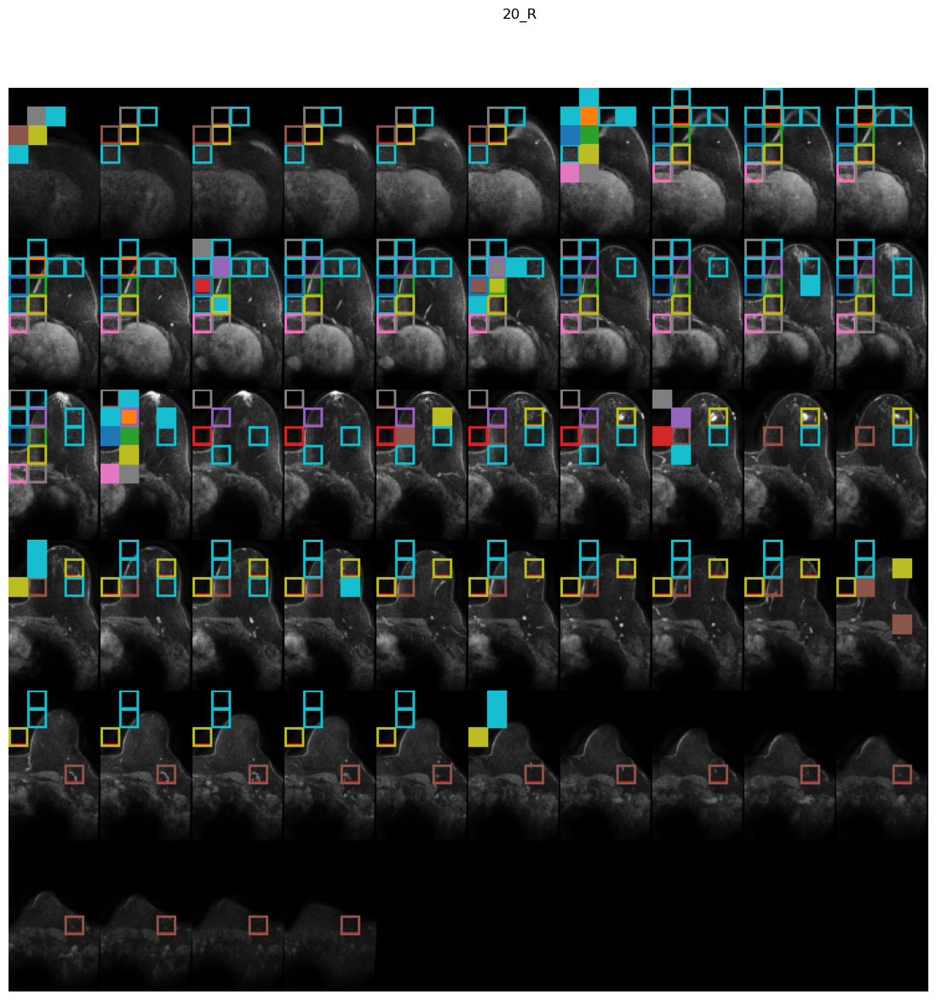

In [43]:
plt.clf()
plotTop=1
locExplanationsSub=[(k,v[1]) for k,v in locExplanations[patientKey][0].items()]
locExplanationsSub.sort(key = lambda x: x[1],reverse=True)
plot_local_explanation(xs.unsqueeze(0), {k:locExplanations[patientKey][0][k] for k in [i[0] for i in locExplanationsSub[:plotTop]] }, title=patientKey)

In [63]:
{k:locExplanations[patientKey][0][k] for k in [i[0] for i in locExplanationsSub[:plotTop]] }

{219: ((6, 21, 30, 45, 0, 15), 7.8998194),
 327: ((6, 21, 15, 30, 15, 30), 6.3830442),
 410: ((6, 21, 30, 45, 15, 30), 3.1193266),
 490: ((12, 27, 30, 45, 0, 15), 3.076473),
 188: ((12, 27, 15, 30, 15, 30), 3.0572853)}

<Figure size 640x480 with 0 Axes>

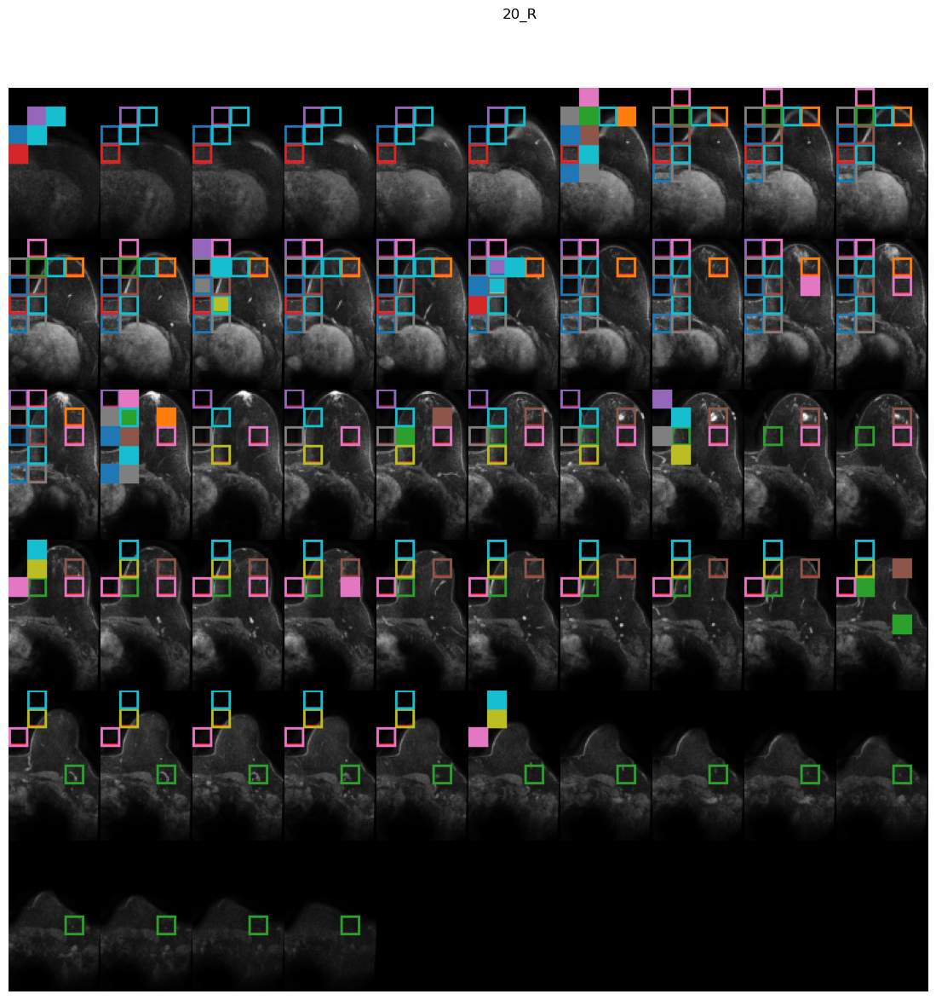

In [69]:
plt.clf()
plot_local_explanation(xs.unsqueeze(0), {}, title=patientKey)

In [54]:
softmaxes.shape

torch.Size([512, 7, 7, 5])

In [41]:
classification_weights.shape

torch.Size([2, 512])

In [51]:
classification_weights.cpu().detach().numpy()*clamped_pooled

array([[0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.03617075, 0.        ,
        0.        ]], dtype=float32)

In [39]:
all_tensors = []
current_fold=1
nonZeroSave=set()

for p in range(net.module._num_prototypes):
    if saved[p] > 0:
        text = "f_" + str(current_fold) + " p_" + str(p)
        print(text)
        nonZeroSave.add(text)
        for img_name, tensor, ps_coord in zip(
                    img_prototype[p],
                    tensors_per_prototype[p],
                    proto_coord[p]):
            #key,subKey=img_name.split("_")
            img_tensor,label=projectloader.dataset[img_name]
            img_tensor = img_tensor.unsqueeze_(0)
            d_min = ps_coord[0]
            d_max = ps_coord[1]
            h_min = ps_coord[2]
            h_max = ps_coord[3]
            w_min = ps_coord[4]
            w_max = ps_coord[5]

            # Create a binary mask for the cube's edges
            edges_mask = torch.zeros_like(img_tensor)
            erosion_mask = torch.zeros_like(img_tensor)
            
            edges_mask[:, 0, d_min:d_max+1, h_min:h_max+1, w_min:w_max+1] = 1
            erosion_mask[:, 0, d_min+1:d_max, h_min+2:h_max-2, w_min+2:w_max-1] = 1
            edges_mask = edges_mask - erosion_mask
            edges_mask = (edges_mask > 0).to(dtype=torch.bool)
            
            img_tensor[edges_mask] = 1
            image = img_tensor.detach().cpu().numpy() # shape: (1, 3, slices, rows, cols)
            
print(len(nonZeroSave))

f_1 p_26
f_1 p_30
f_1 p_58
f_1 p_76
f_1 p_80
f_1 p_95
f_1 p_137
f_1 p_172
f_1 p_189
f_1 p_190
f_1 p_196
f_1 p_206
f_1 p_211
f_1 p_229
f_1 p_236
f_1 p_252
f_1 p_278
f_1 p_282
f_1 p_303
f_1 p_327
f_1 p_347
f_1 p_366
f_1 p_372
f_1 p_384
f_1 p_424
f_1 p_450
f_1 p_452
f_1 p_458
f_1 p_479
f_1 p_507
f_1 p_509
31


In [38]:
img_tensor.shape

torch.Size([1, 3, 51, 101, 72])

In [46]:
arr,label=projectloader.dataset[subsetKeys[2]]

In [47]:
arr.shape

torch.Size([3, 51, 101, 72])

In [26]:
arr2=projectloader.dataset[2][0].unsqueeze_(0)

In [27]:
arr2.shape

torch.Size([1, 3, 51, 101, 72])

In [66]:


def frame_args(duration):
    return {
            "frame": {"duration": duration},
            "mode": "immediate",
            "fromcurrent": True,
            "transition": {"duration": duration, "easing": "linear"},
        }


def sliceViewer3D(volume,rgb=True):
    #assert len(volume.shape)==3
    if not rgb and len(volume.shape)==3:
        volume=volume.unsqueeze(0)
    channels,nb_frames,r,c=volume.shape
    volumeRGB=np.moveaxis(volume,[0,1,2,3],[-1,0,1,2])

    zMax=nb_frames/10 #TODO make this an arg with some scalar associated to the slice width in world space

    custom_colorscale = [[0, 'rgb(0, 0, 0)'], [1, 'rgb(255, 255, 255)']]

    fig =  go.Figure(frames=[go.Frame(data=go.Surface(
    z=(zMax - k * 0.1) * np.ones((r, c)),
    surfacecolor=volumeRGB[nb_frames-1- k],
    cmin=0, cmax=1
    ),
    name=str(k) # you need to name the frame for the animation to behave properly
    )
    for k in range(nb_frames)])

    fig.add_trace(go.Surface(
    z=zMax * np.ones((r, c)),
    surfacecolor=volumeRGB[nb_frames-1],
    colorscale=custom_colorscale,
    cmin=0, cmax=1,
    colorbar=dict(thickness=20, ticklen=4)
    ))

    sliders = [
            {
                "pad": {"b": 10, "t": 60},
                "len": 0.9,
                "x": 0.1,
                "y": 0,
                "steps": [
                    {
                        "args": [[f.name], frame_args(0)],
                        "label": str(k),
                        "method": "animate",
                    }
                    for k, f in enumerate(fig.frames)
                ],
            }
        ]

    fig.update_layout(
         title='Slices in volumetric data',
         width=600,
         height=600,
         scene=dict(
                    zaxis=dict(range=[-0.1, zMax+.1], autorange=False),
                    aspectratio=dict(x=1, y=1, z=1),
                    camera=dict(
                        eye=dict(x=0, y=0, z=2)  # Set initial camera position
                        )
                    ),
         updatemenus = [
            {
                "buttons": [
                    {
                        "args": [None, frame_args(50)],
                        "label": "&#9654;", # play symbol
                        "method": "animate",
                    },
                    {
                        "args": [[None], frame_args(0)],
                        "label": "&#9724;", # pause symbol
                        "method": "animate",
                    },
                ],
                "direction": "left",
                "pad": {"r": 10, "t": 70},
                "type": "buttons",
                "x": 0.1,
                "y": 0,
            }
         ],
         sliders=sliders
    )
    fig.show()



In [62]:
def sliceViewer3D(volume,rgb=True):
    #assert len(volume.shape)==3
    nb_frames,r,c=volume.shape
    zMax=nb_frames/10 #TODO make this an arg with some scalar associated to the slice width in world space

    fig =  go.Figure(frames=[go.Frame(data=go.Surface(
    z=(zMax - k * 0.1) * np.ones((r, c)),
    surfacecolor=volume[nb_frames-1- k],
    cmin=0, cmax=1
    ),
    name=str(k) # you need to name the frame for the animation to behave properly
    )
    for k in range(nb_frames)])

    fig.add_trace(go.Surface(
    z=zMax * np.ones((r, c)),
    surfacecolor=volume[nb_frames-1],
    colorscale='Gray',
    cmin=0, cmax=1,
    colorbar=dict(thickness=20, ticklen=4)
    ))

    sliders = [
            {
                "pad": {"b": 10, "t": 60},
                "len": 0.9,
                "x": 0.1,
                "y": 0,
                "steps": [
                    {
                        "args": [[f.name], frame_args(0)],
                        "label": str(k),
                        "method": "animate",
                    }
                    for k, f in enumerate(fig.frames)
                ],
            }
        ]

    fig.update_layout(
         title='Slices in volumetric data',
         width=600,
         height=600,
         scene=dict(
                    zaxis=dict(range=[-0.1, zMax+.1], autorange=False),
                    aspectratio=dict(x=1, y=1, z=1),
                    camera=dict(
                        eye=dict(x=0, y=0, z=2)  # Set initial camera position
                        )
                    ),
         updatemenus = [
            {
                "buttons": [
                    {
                        "args": [None, frame_args(50)],
                        "label": "&#9654;", # play symbol
                        "method": "animate",
                    },
                    {
                        "args": [[None], frame_args(0)],
                        "label": "&#9724;", # pause symbol
                        "method": "animate",
                    },
                ],
                "direction": "left",
                "pad": {"r": 10, "t": 70},
                "type": "buttons",
                "x": 0.1,
                "y": 0,
            }
         ],
         sliders=sliders
    )
    fig.show()



In [71]:
sliceViewer3D(arr)

In [51]:
arr.shape

torch.Size([3, 51, 101, 72])

In [52]:
arr[:].shape

torch.Size([3, 51, 101, 72])

In [27]:
arr.shape

torch.Size([3, 51, 101, 72])

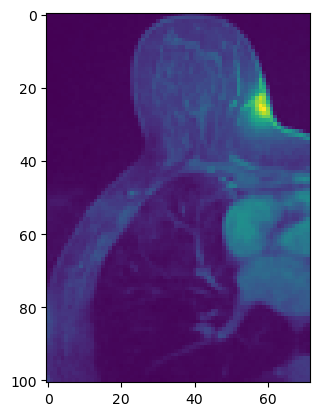

In [14]:
plt.imshow(arr[25])